In [1]:
import pandas as pd

In [2]:
df=pd.read_csv("Laterite_classification_expanded.csv")

In [3]:
df

,Laterite Type,Ds,UCS,IS50,TS,Pw,Di,Mc,RQD
0,ILT,0.75,15.00,2.66,2.08,2525.00,1.61,2.18,32.00
1,LT,5.00,9.50,1.90,1.55,2228.00,2.05,3.91,24.00
2,LTC,8.00,5.09,0.90,0.86,1437.00,1.87,4.76,16.00
3,LLT,15.00,22.65,3.22,2.81,3002.00,3.20,1.74,35.00
4,ILT,1.25,14.89,2.27,1.75,2298.00,1.77,2.00,35.00
...,...,...,...,...,...,...,...,...,...
495,LTC,9.43,6.44,0.82,0.50,1518.76,1.77,4.62,13.93
496,LTC,7.97,5.82,0.42,0.81,1830.46,2.09,5.14,20.72
497,LTC,12.15,4.17,0.36,0.33,1755.00,1.81,5.08,14.57
498,LT,2.56,11.17,0.86,1.14,2149.00,1.81,3.84,30.55


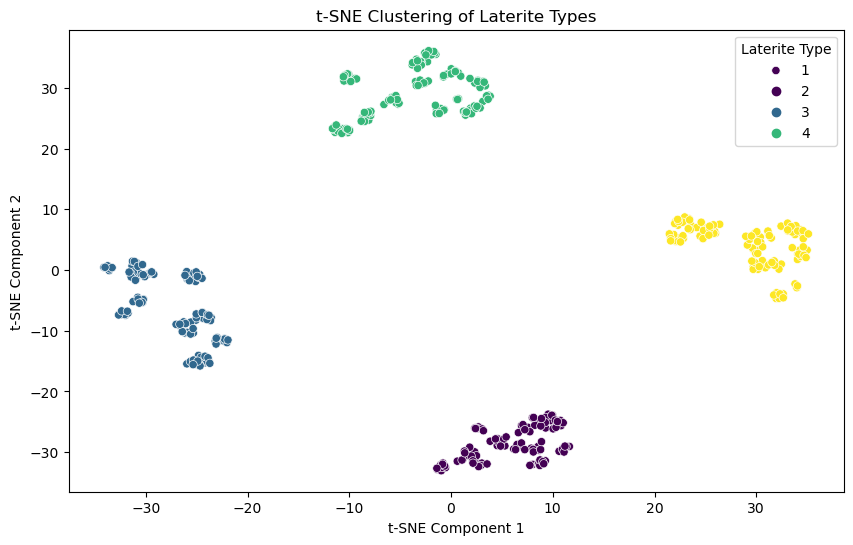

In [64]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler, LabelEncoder



# Encode the categorical Laterite Type
label_encoder = LabelEncoder()
df["Laterite Type"] = label_encoder.fit_transform(df["Laterite Type"])

# Select numerical features for clustering
features = ["Ds", "UCS", "IS50", "TS", "Pw", "Di", "Mc", "RQD"]
X = df[features]

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42, perplexity=30, learning_rate=200)
X_tsne = tsne.fit_transform(X_scaled)

# Convert to DataFrame for easy plotting
df_tsne = pd.DataFrame(X_tsne, columns=["TSNE1", "TSNE2"])
df_tsne["Laterite Type"] = df["Laterite Type"]

# Plot the clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x="TSNE1", y="TSNE2", hue=df_tsne["Laterite Type"], palette="viridis", data=df_tsne)
plt.title("t-SNE Clustering of Laterite Types")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.legend(title="Laterite Type", labels=label_encoder.classes_)
plt.show()


In [65]:
df = df.replace({'Laterite Type': {'ILT': 1, 'LT': 2, 'LTC': 3, 'LLT': 4}})

In [63]:
df.head(100)

,Laterite Type,Ds,UCS,IS50,TS,Pw,Di,Mc,RQD,Cluster
0,1,0.75,15.00,2.66,2.08,2525.00,1.61,2.18,32.00,3
1,2,5.00,9.50,1.90,1.55,2228.00,2.05,3.91,24.00,2
2,3,8.00,5.09,0.90,0.86,1437.00,1.87,4.76,16.00,0
3,4,15.00,22.65,3.22,2.81,3002.00,3.20,1.74,35.00,1
4,1,1.25,14.89,2.27,1.75,2298.00,1.77,2.00,35.00,3
...,...,...,...,...,...,...,...,...,...,...
95,2,6.10,11.52,1.64,1.09,1903.14,2.03,3.26,21.83,2
96,3,12.37,5.52,0.59,0.86,1468.71,1.78,3.96,12.88,0
97,2,3.73,11.78,1.69,0.87,2368.47,2.16,3.17,22.41,2
98,4,12.76,18.99,2.35,2.13,2709.27,3.14,1.67,30.03,1


In [18]:
dataset=pd.read_csv("Laterite_classification_expanded.csv")

In [19]:
dataset

,Laterite Type,Ds,UCS,IS50,TS,Pw,Di,Mc,RQD
0,ILT,0.75,15.00,2.66,2.08,2525.00,1.61,2.18,32.00
1,LT,5.00,9.50,1.90,1.55,2228.00,2.05,3.91,24.00
2,LTC,8.00,5.09,0.90,0.86,1437.00,1.87,4.76,16.00
3,LLT,15.00,22.65,3.22,2.81,3002.00,3.20,1.74,35.00
4,ILT,1.25,14.89,2.27,1.75,2298.00,1.77,2.00,35.00
...,...,...,...,...,...,...,...,...,...
495,LTC,9.43,6.44,0.82,0.50,1518.76,1.77,4.62,13.93
496,LTC,7.97,5.82,0.42,0.81,1830.46,2.09,5.14,20.72
497,LTC,12.15,4.17,0.36,0.33,1755.00,1.81,5.08,14.57
498,LT,2.56,11.17,0.86,1.14,2149.00,1.81,3.84,30.55


In [55]:
df.describe()

,Ds,UCS,IS50,TS,Pw,Di,Mc,RQD,Cluster
count,500.00000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000,500.000000
mean,8.03592,12.020820,1.507040,1.405660,2218.923020,2.198760,3.005940,26.944280,1.414000
std,5.41438,5.665666,0.780933,0.601127,540.844175,0.612621,1.108564,8.384084,1.110437
min,0.51000,3.530000,0.310000,0.310000,1286.830000,1.450000,1.440000,12.880000,0.000000
25%,3.72000,6.385000,0.802500,0.917500,1765.412500,1.800000,1.920000,20.435000,0.000000
50%,7.64000,11.780000,1.560000,1.405000,2171.135000,1.940000,3.150000,27.000000,1.000000
75%,11.80000,16.830000,2.132500,1.852500,2567.380000,2.690000,3.960000,32.602500,2.000000
max,21.92000,24.170000,3.500000,3.000000,3479.060000,3.820000,5.350000,49.610000,3.000000


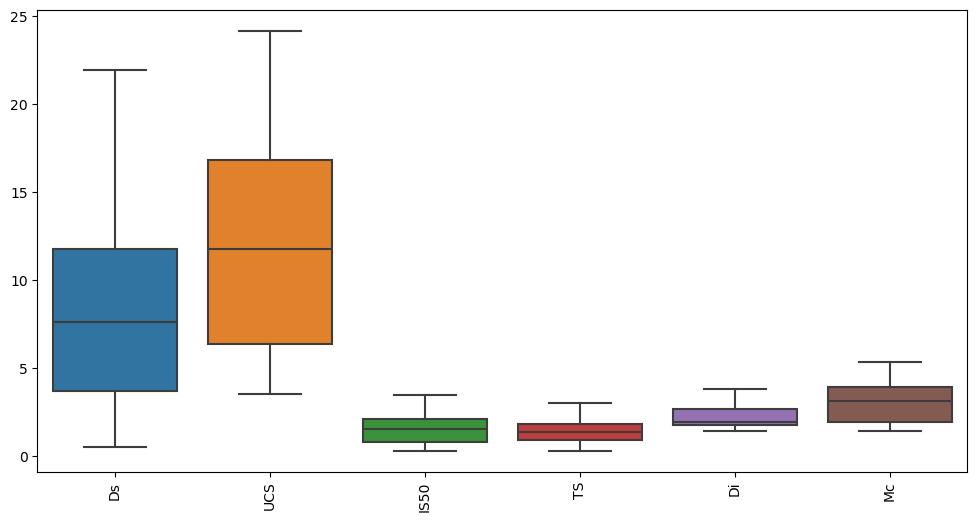

In [103]:
# Plot boxplots to visualize outliers
plt.figure(figsize=(12, 6))
sns.boxplot(data=df.drop(columns=['Pw','RQD']))
plt.xticks(rotation=90)
plt.show()

# Remove outliers using Z-score method
from scipy.stats import zscore

z_scores = np.abs(zscore(df.drop(columns=['Laterite Type'])))  # Exclude target column
df = df[(z_scores < 3).all(axis=1)]  # Keep only values within 3 standard deviations


C:\Users\Vijay Kumar\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Vijay Kumar\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Vijay Kumar\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Vijay Kumar\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values

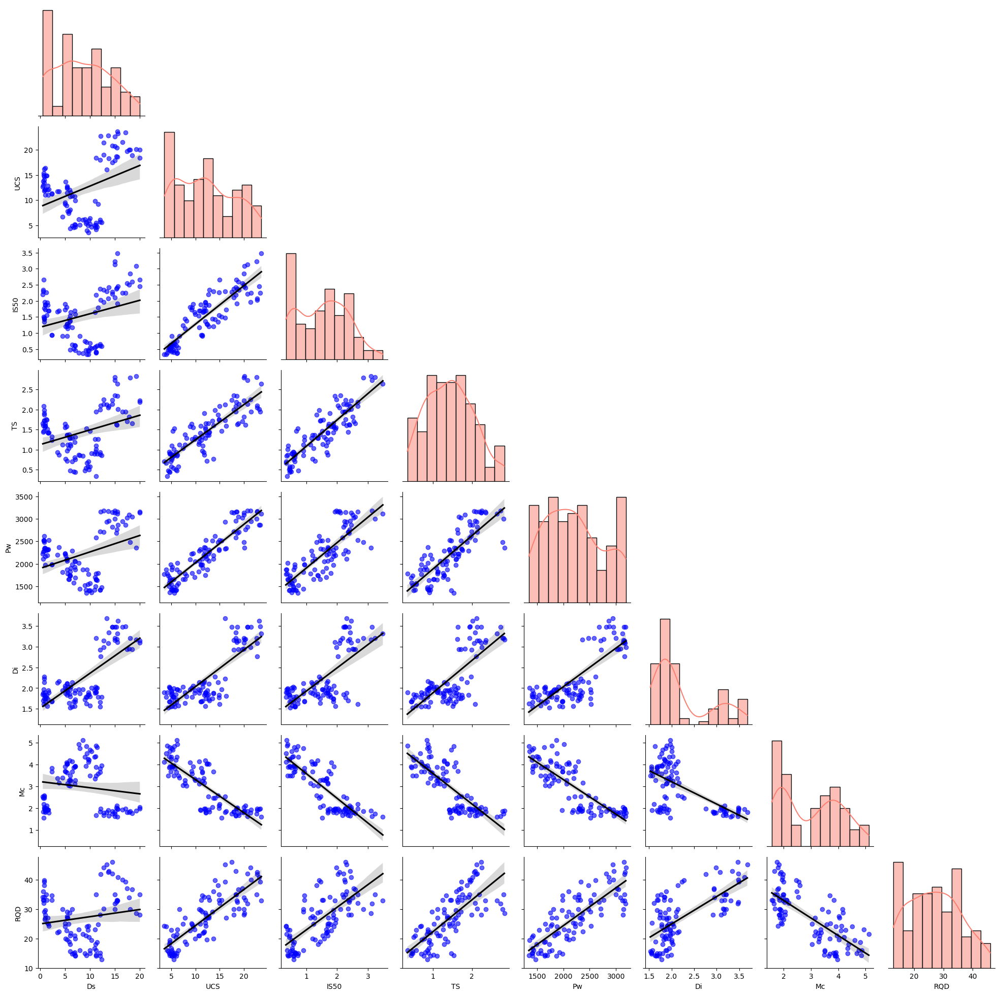

In [73]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats

# Load your dataset (Ensure it contains 8 features + 'laterite_type' as target)
 

# Define a function to calculate and display correlation values
def corrfunc(x, y, **kwargs):
    r, _ = stats.pearsonr(x, y)  # Pearson correlation
    ax = plt.gca()
    ax.set_facecolor('lightcoral')  # Red background for correlation values
    ax.annotate(f'{r:.2f}', xy=(0.5, 0.5), xycoords=ax.transAxes, ha='center', fontsize=12, fontweight='bold', color='black')

# Create the PairGrid
g = sns.PairGrid(df.head(100), diag_sharey=False, corner=True)

# Scatter plots with regression lines in the lower triangle
g.map_lower(sns.regplot, scatter_kws={'color': 'blue', 'alpha': 0.6}, line_kws={'color': 'black'})

# Bar plots (histograms) on the diagonal
g.map_diag(sns.histplot, kde=True, color="salmon", bins=10)

# Correlation values in the upper triangle
g.map_upper(corrfunc)

plt.show()


C:\Users\Vijay Kumar\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\Vijay Kumar\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_data = data.groupby(
C:\Users\Vijay Kumar\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1075: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
C:\Users\Vijay Kumar\anaconda3\Lib\site-packages\seaborn\_oldcore.p

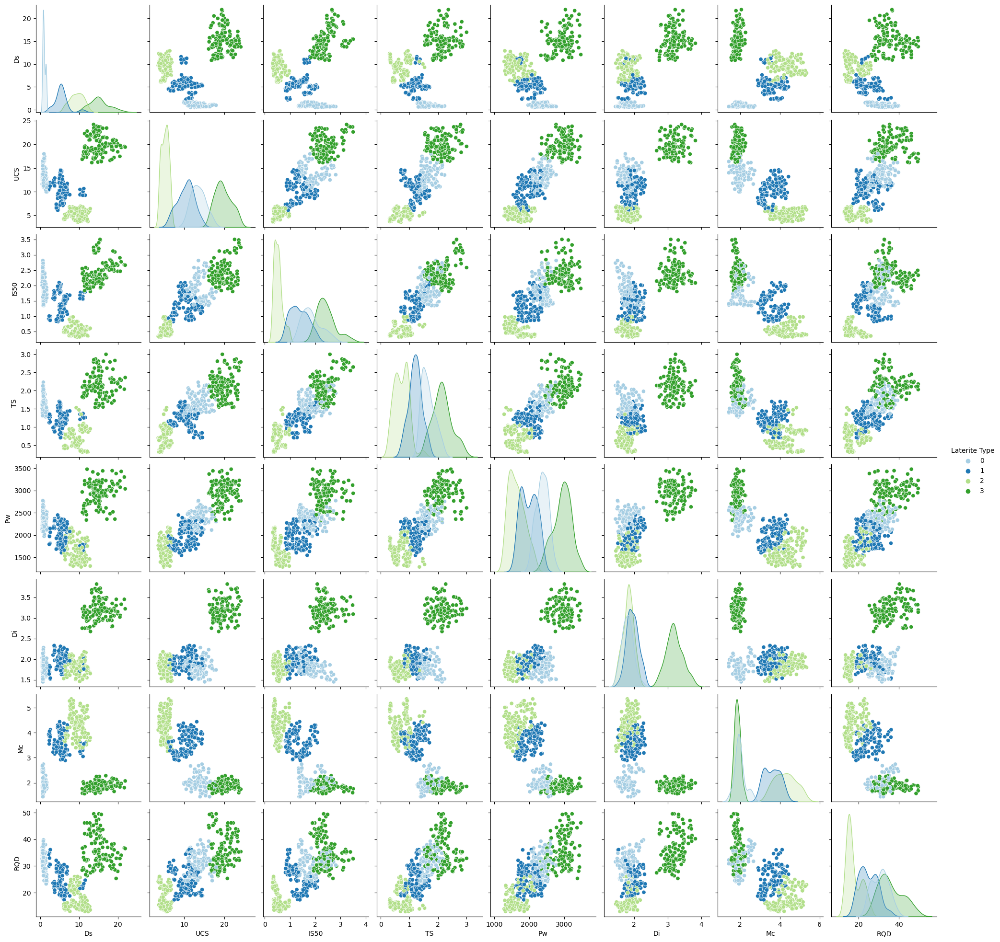

In [78]:

# Pairplot for pairwise relationships
sns.pairplot(df, hue="Laterite Type", palette="Paired")
plt.show()
#Purpose: Analyze how features interact with each other.

In [25]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split  # Import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import accuracy_score
from sklearn.ensemble import RandomForestClassifier

# Load the dataset (assuming you have it loaded as `dataset`)
# dataset = pd.read_csv("your_file_path.csv") # Uncomment this line to load your dataset

# Encode the categorical Laterite Type into numerical labels
label_encoder = LabelEncoder()
dataset["Laterite Type Encoded"] = label_encoder.fit_transform(dataset["Laterite Type"])

# Select numerical features for classification
features = ["Ds", "UCS", "IS50", "TS", "Pw", "Di", "Mc", "RQD"]
X = dataset[features]  # Features for training
y = dataset["Laterite Type Encoded"]  # Target variable (Laterite Type encoded)

# Standardize the features for better model performance
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Split the data into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Train a Random Forest Classifier model
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)  # Train the model on the training data

# Predict using the trained model on the test data
y_pred = rf_model.predict(X_test)

# Evaluate the model's accuracy on the test data
accuracy = accuracy_score(y_test, y_pred)
print(f"Classification Model Accuracy on Test Data: {accuracy:.4f}")



Classification Model Accuracy on Test Data: 1.0000


In [100]:
# Function to predict Laterite Type based on user input
def predict_laterite_type():
    print("\nEnter the 8 input properties:")
    user_input = []
    for feature in features:
        value = float(input(f"{feature}: "))
        user_input.append(value)
    
    # Convert input to the required format
    user_scaled = scaler.transform([user_input])
    
    # Predict using trained model
    predicted_label = rf_model.predict(user_scaled)[0]
    
    # Decode the predicted label to the respective Laterite Type
    predicted_laterite_type = label_encoder.inverse_transform([predicted_label])[0]
    
    print("\n🔹 Predicted Result:")
    print(f"   - Encoded Label: {predicted_label}")
    print(f"   - Laterite Type: {predicted_laterite_type}")

# Run the prediction function
predict_laterite_type()



Enter the 8 input properties:


Ds:  5.7
UCS:  11.82
IS50:  0.87
TS:  0.96
Pw:  2274.3
Di:  2.23
Mc:  3.96
RQD:  30.02



🔹 Predicted Result:
   - Encoded Label: 2
   - Laterite Type: LT


C:\Users\Vijay Kumar\anaconda3\Lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


## 1. Feature Importance Plot

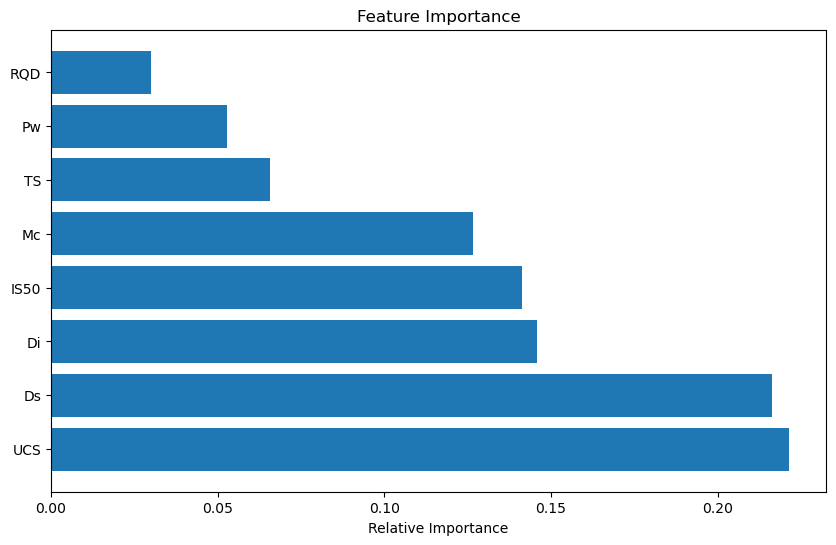

In [29]:
# The Feature Importance plot shows which features have the most impact on the model’s predictions.


importances = rf_model.feature_importances_
indices = np.argsort(importances)[::-1]  # Sort features by importance

# Plotting the Feature Importance
plt.figure(figsize=(10, 6))
plt.title("Feature Importance")
plt.barh(range(X.shape[1]), importances[indices], align="center")
plt.yticks(range(X.shape[1]), np.array(features)[indices])
plt.xlabel("Relative Importance")
plt.show()


## 2. Confusion Matrix

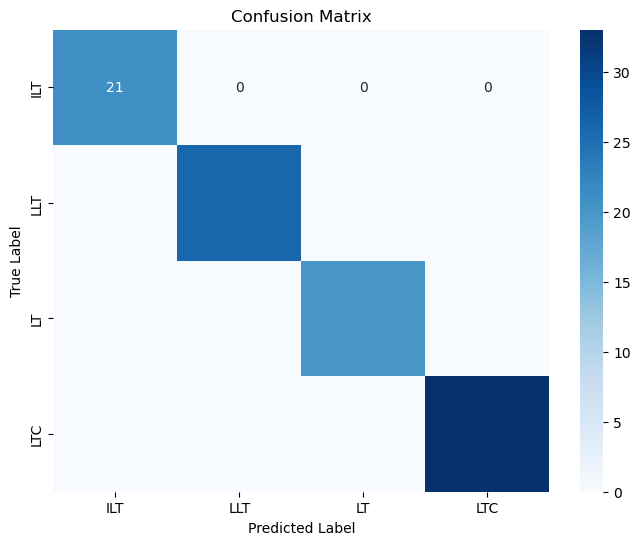

In [32]:
#The Confusion Matrix gives insight into how many predictions were correct and where the model might have confused one class for another.

from sklearn.metrics import confusion_matrix
import seaborn as sns

# Get confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()


## 3. ROC Curve


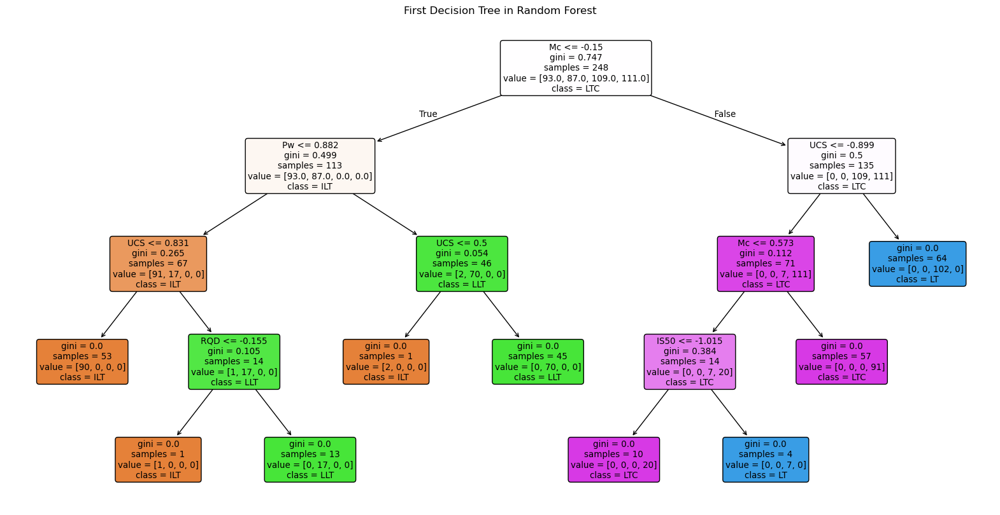

In [42]:
from sklearn.tree import plot_tree

# Plot the first tree in the Random Forest
plt.figure(figsize=(20, 10))
plot_tree(rf_model.estimators_[0], filled=True, feature_names=features, class_names=label_encoder.classes_, rounded=True)
plt.title("First Decision Tree in Random Forest")
plt.show()


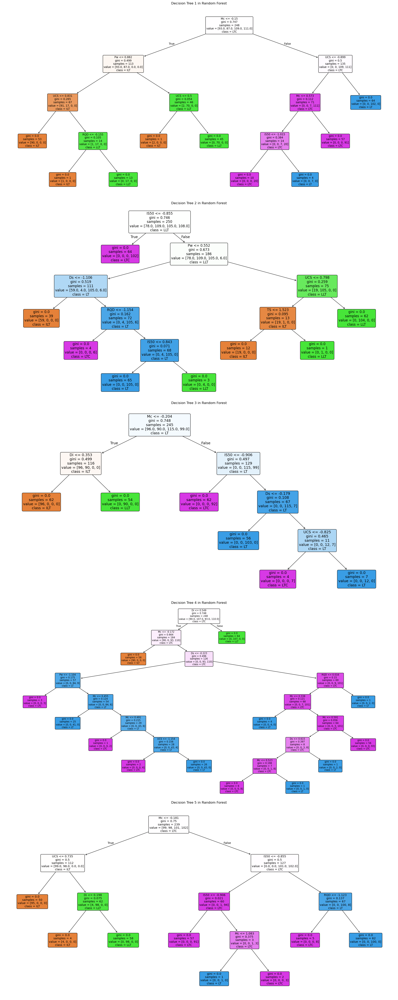

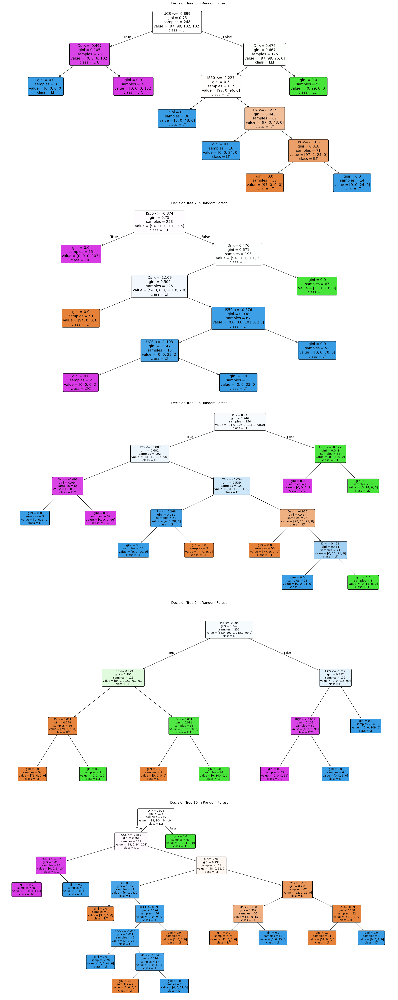

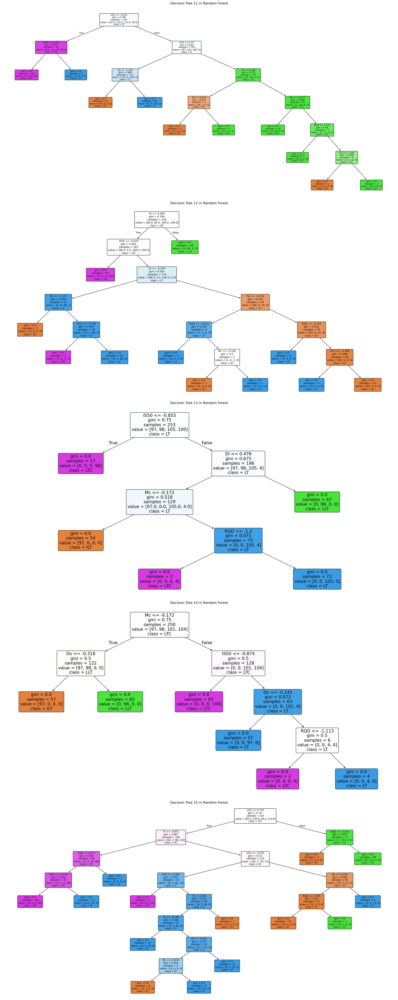

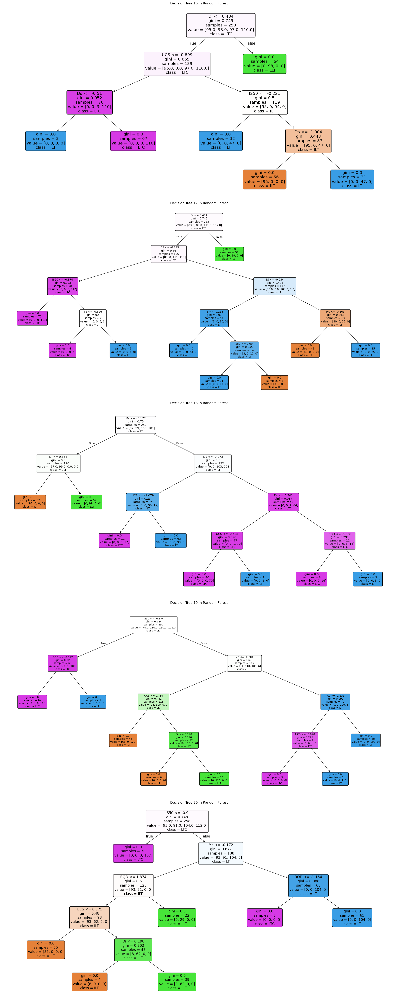

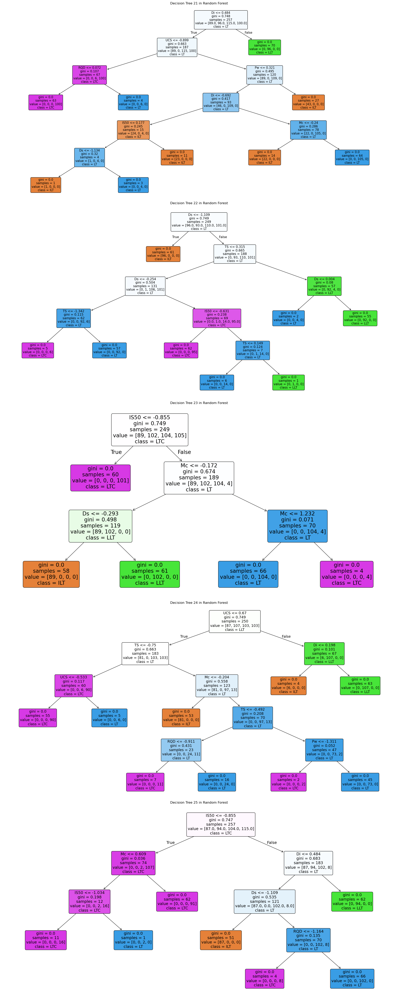

...

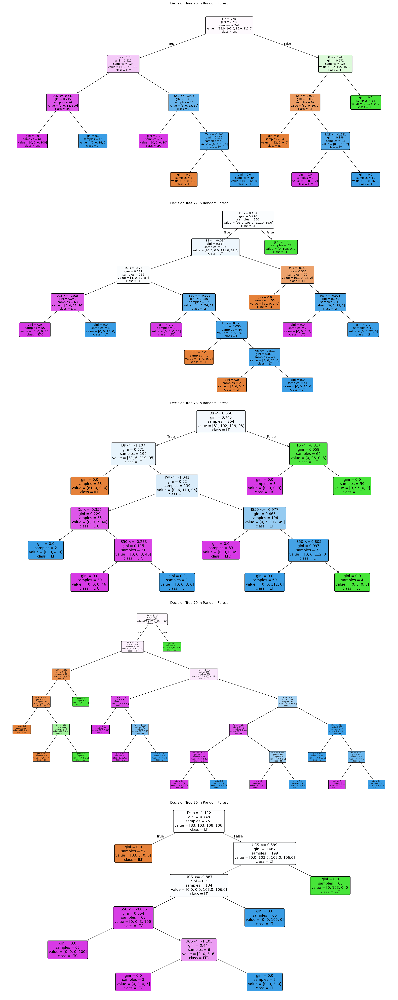

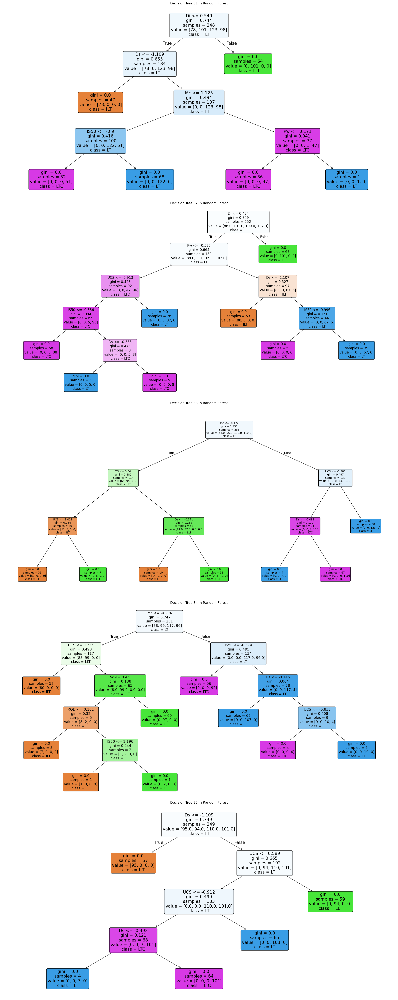

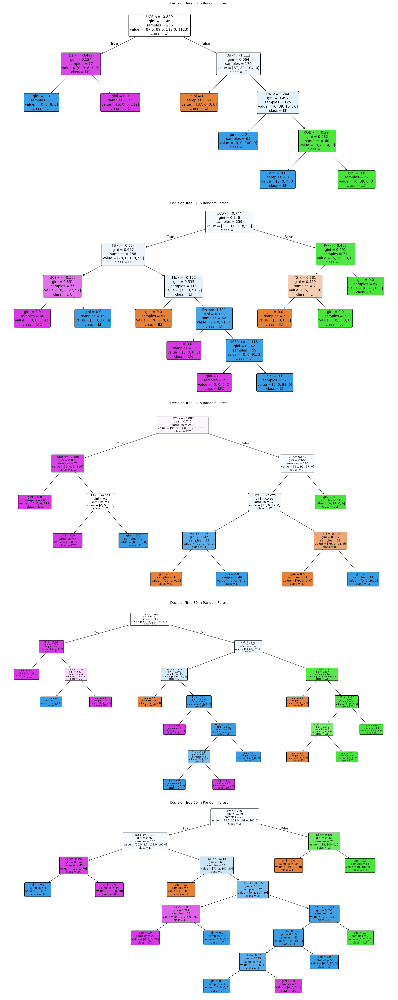

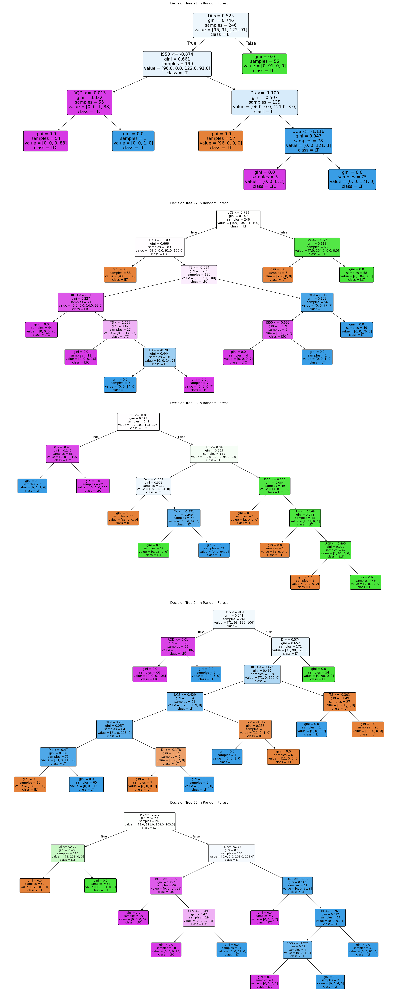

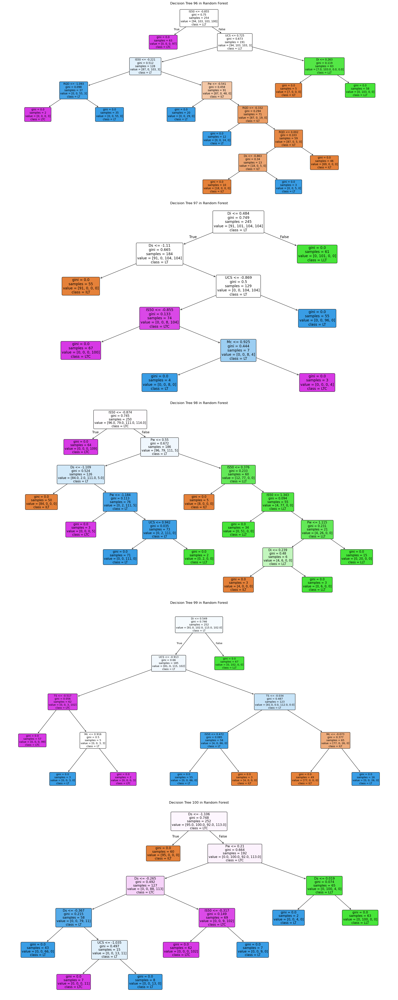

In [44]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Set up the plot parameters
trees_per_plot = 5  # Number of trees per plot (you can adjust this value)
n_trees = len(rf_model.estimators_)  # Total number of trees in the forest

# Calculate the number of batches needed
n_batches = (n_trees // trees_per_plot) + (1 if n_trees % trees_per_plot != 0 else 0)

# Plot each batch of trees
for batch in range(n_batches):
    start_idx = batch * trees_per_plot
    end_idx = min((batch + 1) * trees_per_plot, n_trees)
    
    # Create subplots for the current batch
    fig, axes = plt.subplots(end_idx - start_idx, 1, figsize=(20, 10 * (end_idx - start_idx)))
    
    # Plot each tree in the batch
    for i, ax in enumerate(axes):
        tree_idx = start_idx + i
        plot_tree(rf_model.estimators_[tree_idx], 
                  filled=True, 
                  feature_names=features, 
                  class_names=label_encoder.classes_, 
                  rounded=True, 
                  ax=ax)
        ax.set_title(f"Decision Tree {tree_idx + 1} in Random Forest")
    
    # Adjust layout and display the batch plot
    plt.tight_layout()
    plt.show()


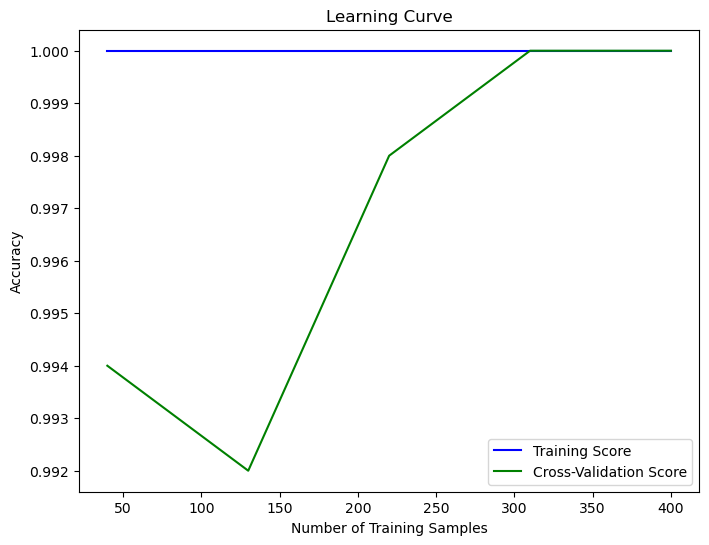

In [37]:
from sklearn.model_selection import learning_curve

# Calculate learning curve
train_sizes, train_scores, test_scores = learning_curve(rf_model, X_scaled, y, cv=5, scoring="accuracy", n_jobs=-1)

# Plot Learning Curve
plt.figure(figsize=(8, 6))
plt.plot(train_sizes, np.mean(train_scores, axis=1), label="Training Score", color='blue')
plt.plot(train_sizes, np.mean(test_scores, axis=1), label="Cross-Validation Score", color='green')
plt.title("Learning Curve")
plt.xlabel("Number of Training Samples")
plt.ylabel("Accuracy")
plt.legend(loc="best")
plt.show()


In [57]:
import pandas as pd



# Group the data by Laterite Type and calculate the range (min, max) for each property
range_df = dataset.groupby('Laterite Type').agg({
    'Ds': ['min', 'max'],
    'UCS': ['min', 'max'],
    'IS50': ['min', 'max'],
    'TS': ['min', 'max'],
    'Pw': ['min', 'max'],
    'Di': ['min', 'max'],
    'Mc': ['min', 'max'],
    'RQD': ['min', 'max']
})

# Flatten the multi-level column index
range_df.columns = [f'{col[0]}_{col[1]}' for col in range_df.columns]

# Reset index to make it more readable
range_df = range_df.reset_index()

# Apply color styling with a single light color
styled_df = range_df.style.background_gradient(cmap='Blues', axis=None) \
                          .set_table_styles([{'selector': 'thead th', 
                                              'props': [('background-color', 'lightblue'),
                                                       ('color', 'black')]}])

# Display the colorful table
styled_df


,Laterite Type,Ds_min,Ds_max,UCS_min,UCS_max,IS50_min,IS50_max,TS_min,TS_max,Pw_min,Pw_max,Di_min,Di_max,Mc_min,Mc_max,RQD_min,RQD_max
0,ILT,0.510000,1.740000,9.920000,17.980000,1.340000,2.810000,1.280000,2.230000,1973.970000,2773.410000,1.450000,2.280000,1.440000,2.740000,23.300000,39.820000
1,LLT,10.830000,21.920000,16.130000,24.170000,1.800000,3.500000,1.540000,3.000000,2338.100000,3479.060000,2.670000,3.820000,1.560000,2.280000,25.340000,49.610000
2,LT,2.180000,11.610000,6.080000,14.580000,0.820000,2.090000,0.700000,1.700000,1547.300000,2450.440000,1.520000,2.330000,2.890000,4.440000,17.310000,36.150000
3,LTC,6.060000,12.900000,3.530000,6.920000,0.310000,0.970000,0.310000,1.530000,1286.830000,2172.480000,1.460000,2.180000,3.260000,5.350000,12.880000,26.070000


C:\Users\Vijay Kumar\AppData\Local\Temp\ipykernel_12932\2243446883.py:33: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(data=range_df_melted, x='Laterite Type', y='Value', hue='Property', ci=None, palette=palette)


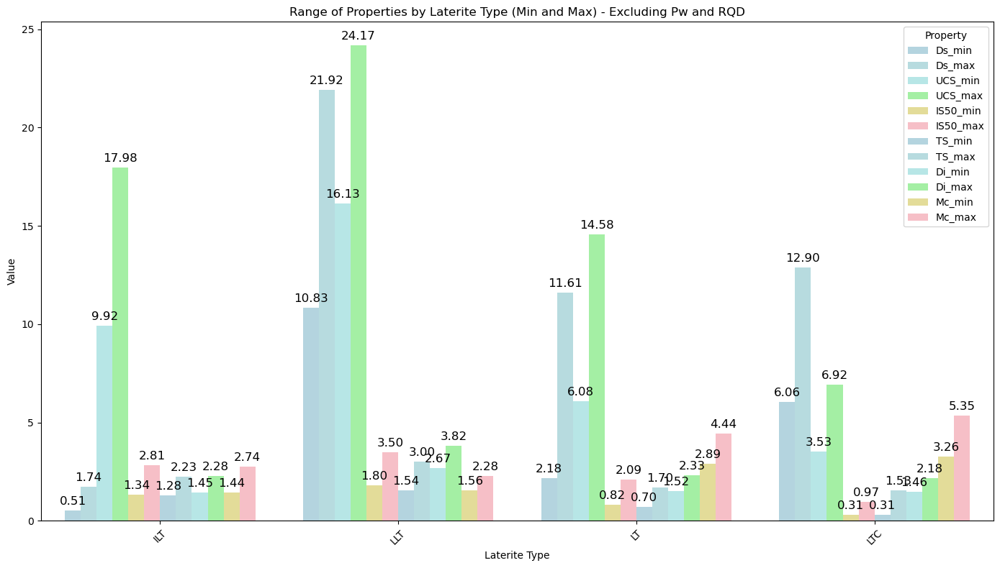

In [91]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Group the data by Laterite Type and calculate the range (min, max) for each property
range_df = dataset.groupby('Laterite Type').agg({
    'Ds': ['min', 'max'],
    'UCS': ['min', 'max'],
    'IS50': ['min', 'max'],
    'TS': ['min', 'max'],
    'Di': ['min', 'max'],
    'Mc': ['min', 'max']
})

# Flatten the multi-level column index
range_df.columns = [f'{col[0]}_{col[1]}' for col in range_df.columns]

# Reset index to make it more readable
range_df = range_df.reset_index()

# Reshape the data for better plotting (excluding Pw and RQD)
range_df_melted = range_df.melt(id_vars=["Laterite Type"], var_name="Property", value_name="Value")

# Filter out the 'Pw' and 'RQD' properties
range_df_melted = range_df_melted[~range_df_melted['Property'].str.contains('Pw|RQD')]

# Define a custom palette with 6 different light colors
palette = ['#add8e6', '#b0e0e6', '#afeeee', '#98fb98', '#f0e68c', '#ffb6c1']  # Light blue, light cyan, light green, etc.

# Plot the ranges (min and max) using Seaborn barplot with a custom palette
plt.figure(figsize=(14, 8))

sns.barplot(data=range_df_melted, x='Laterite Type', y='Value', hue='Property', ci=None, palette=palette)

# Add numerical values on top of the bars horizontally
ax = plt.gca()
for p in ax.patches:
    ax.annotate(f'{p.get_height():.2f}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', 
                fontsize=12, color='black', 
                xytext=(0, 9), textcoords='offset points')

    # Add property names directly on the bars (min and max)
    property_name = p.get_label().split('_')[0]  # Extract the property name (e.g., Ds, UCS)
    ax.annotate(property_name, 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', 
                fontsize=12, color='black', 
                xytext=(0, -15), textcoords='offset points')  # Adjust position for property name

# Customize the plot title and axis labels
plt.title('Range of Properties by Laterite Type (Min and Max) - Excluding Pw and RQD')
plt.xlabel('Laterite Type')
plt.ylabel('Value')

# Customize legend
plt.legend(title='Property', loc='upper right')

# Display the plot
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [104]:
!pip install streamlit



[notice] A new release of pip is available: 24.3.1 -> 25.0
[notice] To update, run: python.exe -m pip install --upgrade pip
